In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input,Lambda,Dense,Flatten,Conv2D
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img
from tensorflow.keras.models import Sequential
import numpy as np
import pandas as pd
from glob import glob
import matplotlib.pyplot as plt


In [ ]:
print(tf.__version__)

2.6.0


In [5]:
from google.colab import files
files.upload()

Saving archive.zip to archive.zip


{'archive.zip': b'PK\x03\x04-\x00\x00\x00\x08\x00En&Q\x1f4\xfag\xff\xff\xff\xff\xff\xff\xff\xffI\x00\x14\x00Dataset/Test/Parasite/C39P4thinF_original_IMG_20150622_105554_cell_10.png\x01\x00\x10\x008&\x00\x00\x00\x00\x00\x00=&\x00\x00\x00\x00\x00\x00\x018&\xc7\xd9\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x00|\x00\x00\x00s\x08\x02\x00\x00\x00\xd5*\xf1<\x00\x00\x00\x07tIME\x07\xe0\x07\r\x101\x08Nz\x99\x1f\x00\x00 \x00IDATx\x9c\xdd}]\xcf-\xc9u\xd6\xf3\xac\xaa\xde\xef\x99\x0f#\xfe\x08p\x01D1&\xcaM\xfe\x03 \x11\x88\xed8\xce\x07\xf0G\xe0\xc63\xb6g\x14\x13GBHH\\"\xc5(\x111\xa0\x04\x81\x10\x127\xfc\x0e\xa4\xe0\x99y\xcf\xbbw\xd7Z\\\xac\xaa\xd5\xab\xaa\xf79>g|\xe6\xcc\xc8\xad\xf1q\xbf\xbd\xbb\xab\xab\x9eZ\xdfkU5\xf1Kq\xfc\xf9G\xdf73?\xff\x8d\xdf\xff\xe7_ng~\xeeQ\xbf\xec\x0e\xbc\x99\xa3\xb5\xe6\'$\xbf\xdc\x9e\xbc\xca\xf1\xcb\x02:\xcc\xccHb\xd0\xfbW\xf9\xf8\xea\xd2\xc5\x9f}\xf4!\x003\x02p\xd1\xa1\xaa$I\xda8\x00\x94RT\xd5\xcf\x17273\x11\x89\xc7E\xfc/\xf8\xb3$\xfb\xdf\x00\xc9\xdf\xf8\xee\x1f\xbc\xb

In [7]:
import zipfile
import os
zip_ref=zipfile.ZipFile('/content/archive.zip','r')
zip_ref.extractall('/malariadata')
zip_ref.close()

In [8]:
IMAGE_SIZE=[224,224] #resizing all the images
train_path='/malariadata/Dataset/Train'
test_path='/malariadata/Dataset/Test'


In [9]:
#Importing the vgg19 library
#In the first part we use the pre existing model vgg19 ,later we create another model from scratch and compare both
vgg19=VGG19(input_shape=IMAGE_SIZE +[3],weights='imagenet',include_top=False)



80150528/80134624 [==============================] - 1s 0us/step


In [10]:
vgg19.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [11]:
#there already lies some existing weights and we clear the weights
for layer in vgg19.layers:
  layer.trainable=False

In [13]:
x=Flatten()(vgg19.output)
prediction=Dense(2,activation='softmax')(x)
model=Model(inputs=vgg19.input,outputs=prediction)

In [14]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [17]:
#tell the model what cost and optimization method to use
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [19]:
#We use Imagedatagenerator to import images and rescale the images and create new set of images in possible directions and rotating them from the present format
train_datagen=ImageDataGenerator(rescale=1./255,
                             shear_range=0.2,
                             zoom_range=0.2,
                             horizontal_flip=True)
test_datagen=ImageDataGenerator(rescale=1./255)

In [21]:
training_set=train_datagen.flow_from_directory(train_path,
                                               target_size=(224,224),
                                               batch_size=32,
                                               class_mode='categorical')

Found 416 images belonging to 2 classes.


In [23]:
test_set=test_datagen.flow_from_directory(test_path,
                                          target_size=(224,224),
                                          batch_size=32,
                                          class_mode='categorical')

Found 134 images belonging to 2 classes.


In [25]:
#training the model
r=model.fit(training_set,
            validation_data=test_set,
            epochs=6,
            steps_per_epoch=len(training_set),
            validation_steps=len(test_set))

Epoch 1/6
13/13 [==============================] - 354s 28s/step - loss: 0.4113 - accuracy: 0.8005 - val_loss: 0.6211 - val_accuracy: 0.6567
Epoch 2/6
13/13 [==============================] - 352s 28s/step - loss: 0.3670 - accuracy: 0.8510 - val_loss: 0.4278 - val_accuracy: 0.7612
Epoch 3/6
13/13 [==============================] - 354s 28s/step - loss: 0.3623 - accuracy: 0.8462 - val_loss: 0.4324 - val_accuracy: 0.8060
Epoch 4/6
13/13 [==============================] - 353s 28s/step - loss: 0.3044 - accuracy: 0.8942 - val_loss: 0.4122 - val_accuracy: 0.7985
Epoch 5/6
13/13 [==============================] - 353s 28s/step - loss: 0.2578 - accuracy: 0.9279 - val_loss: 0.3489 - val_accuracy: 0.8806
Epoch 6/6
13/13 [==============================] - 353s 28s/step - loss: 0.2515 - accuracy: 0.9159 - val_loss: 0.4672 - val_accuracy: 0.7388


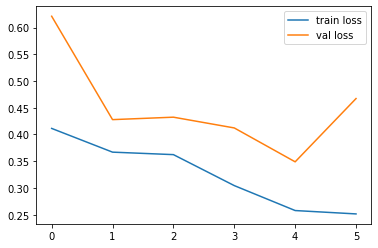

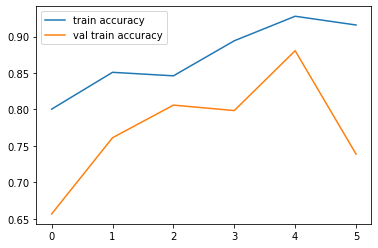

<Figure size 432x288 with 0 Axes>

In [26]:
#plot the loss from the obtained model
plt.plot(r.history['loss'],label='train loss')
plt.plot(r.history['val_loss'],label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')
#plot the accuracy
plt.plot(r.history['accuracy'],label='train accuracy')
plt.plot(r.history['val_accuracy'],label='val train accuracy')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

In [31]:
y_pred=model.predict(test_set)
y_pred

array([[7.03847766e-01, 2.96152264e-01],
       [6.70444667e-01, 3.29555273e-01],
       [1.82471573e-01, 8.17528486e-01],
       [1.15534805e-01, 8.84465218e-01],
       [1.43695861e-01, 8.56304169e-01],
       [2.50407934e-01, 7.49592125e-01],
       [1.39766201e-01, 8.60233843e-01],
       [5.82933426e-01, 4.17066604e-01],
       [9.67792124e-02, 9.03220773e-01],
       [1.54765531e-01, 8.45234454e-01],
       [6.41891211e-02, 9.35810924e-01],
       [9.25622463e-01, 7.43775740e-02],
       [2.04561025e-01, 7.95439005e-01],
       [9.97697890e-01, 2.30208528e-03],
       [1.05367534e-01, 8.94632459e-01],
       [1.06619135e-01, 8.93380880e-01],
       [9.11232233e-01, 8.87677446e-02],
       [7.57794902e-02, 9.24220502e-01],
       [3.39920491e-01, 6.60079539e-01],
       [8.45662951e-01, 1.54336989e-01],
       [7.30537415e-01, 2.69462556e-01],
       [5.49857855e-01, 4.50142145e-01],
       [5.75911462e-01, 4.24088478e-01],
       [9.49259996e-01, 5.07399514e-02],
       [4.623936

In [33]:
y_pred=np.argmax(y_pred,axis=1)

In [34]:
y_pred

array([0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0,
       0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0,
       1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0,
       0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1,
       1, 0])

In [27]:
#save model as h5 file
from tensorflow.keras.models import load_model
model.save('model_vgg19.h5')

In [35]:
#Now we create another model from scratch using CNN without using any preexisting models
from tensorflow.keras.layers import MaxPooling2D
m=Sequential()
m.add(Conv2D(filters=16,kernel_size=2,padding='same',activation='relu',input_shape=(224,224,3)))
m.add(MaxPooling2D(pool_size=2))
m.add(Conv2D(filters=32,kernel_size=2,padding='same',activation='relu'))
m.add(MaxPooling2D(pool_size=2))
m.add(Conv2D(filters=64,kernel_size=2,padding='same',activation='relu'))
m.add(MaxPooling2D(pool_size=2))
m.add(Flatten())
m.add(Dense(500,activation='relu'))
m.add(Dense(2,activation='softmax'))
m.summary()



Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 224, 224, 16)      208       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 112, 112, 16)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 112, 112, 32)      2080      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 56, 56, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 56, 56, 64)        8256      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 28, 28, 64)        0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 50176)             0

In [36]:
m.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [38]:
result=m.fit(training_set,
            validation_data=test_set,
            epochs=10,
            steps_per_epoch=len(training_set),
            validation_steps=len(test_set))

Epoch 1/10
13/13 [==============================] - 23s 2s/step - loss: 0.4512 - accuracy: 0.7812 - val_loss: 0.8194 - val_accuracy: 0.4701
Epoch 2/10
13/13 [==============================] - 21s 2s/step - loss: 0.3901 - accuracy: 0.8125 - val_loss: 1.0680 - val_accuracy: 0.4179
Epoch 3/10
13/13 [==============================] - 21s 2s/step - loss: 0.3518 - accuracy: 0.8365 - val_loss: 0.6419 - val_accuracy: 0.6343
Epoch 4/10
13/13 [==============================] - 21s 2s/step - loss: 0.2944 - accuracy: 0.8870 - val_loss: 0.7124 - val_accuracy: 0.6045
Epoch 5/10
13/13 [==============================] - 21s 2s/step - loss: 0.2397 - accuracy: 0.9135 - val_loss: 0.6646 - val_accuracy: 0.5896
Epoch 6/10
13/13 [==============================] - 21s 2s/step - loss: 0.2650 - accuracy: 0.9135 - val_loss: 0.7694 - val_accuracy: 0.5746
Epoch 7/10
13/13 [==============================] - 21s 2s/step - loss: 0.2678 - accuracy: 0.8918 - val_loss: 0.4828 - val_accuracy: 0.7463
Epoch 8/10
13/13 [==

In [39]:
m.save('finalmodel.h5')